## waveletによるノイズ除去

In [116]:
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import librosa
import warnings
warnings.simplefilter('ignore')
import pywt
import IPython.display as ipd

In [117]:
sns.set_style('white')

In [118]:
DATA_DIR = 'data/'

### 換気扇の音が含まれる音声ファイル

In [119]:
data, sr = librosa.load(DATA_DIR+'noisy_voice.wav', sr=None)

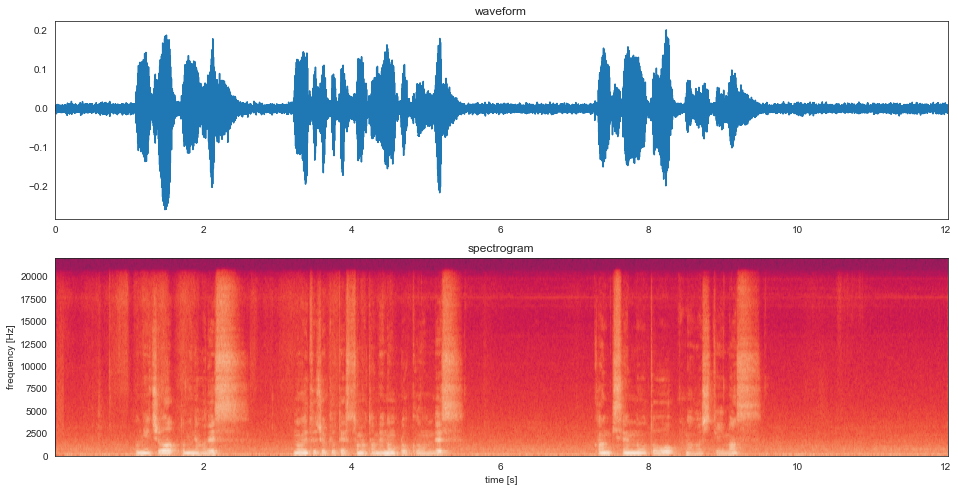

In [120]:
fig, axs = plt.subplots(2, 1, figsize=(16, 8))
axs = axs.ravel()
xs = np.arange(0, len(data)) / sr
axs[0].plot(xs, data)
axs[0].set_title('waveform')
axs[0].set_xlim(0, len(data)/sr)
axs[1].specgram(data, Fs=sr)
axs[1].set_title('spectrogram')
axs[1].set_xlabel('time [s]')
axs[1].set_ylabel('frequency [Hz]')
fig.show()

ipd.Audio(data, rate=sr)

In [121]:
def compare_plot(origin, denoise, sr=44100):
    xs = np.arange(0, len(origin)) / sr
    fig, axs = plt.subplots(4, 1, figsize=(16, 12))
    axs[0].plot(xs, origin)
    axs[0].set_title('original')
    axs[0].set_xlim(0, len(origin)/sr)
    axs[1].specgram(origin, Fs=sr)
    axs[1].set_title('spectrogram')
    axs[1].set_ylim(0, sr/2)
    axs[1].set_xlabel('time [s]')
    axs[1].set_ylabel('frequency [Hz]')
    axs[2].plot(xs, denoise)
    axs[2].set_title('denoise')
    axs[2].set_xlim(0, len(denoise)/sr)
    axs[3].specgram(denoise, Fs=sr)
    axs[3].set_title('denoise spectrogram')
    axs[3].set_ylim(0, sr/2)
    axs[3].set_xlabel('time [s]')
    axs[3].set_ylabel('frequency [Hz]')
    plt.tight_layout()
    fig.show()

    ipd.display('Before')
    ipd.display(ipd.Audio(origin, rate=sr))
    ipd.display('After')
    ipd.display(ipd.Audio(denoise, rate=sr))

---
### 多重解像度分析

In [122]:
coeff = pywt.wavedec(data, 'db1', mode='per')

median = np.median(coeff[-1])
sigma = np.median(abs(coeff[-1]-median)) / 0.6745
threshold = sigma*np.sqrt(2*np.log(len(data)))
coeff[1:] = (pywt.threshold(i, value=threshold, mode='hard') for i in coeff[1:])

denoise_data = pywt.waverec(coeff, 'db1', mode='per')

In [123]:
sigma, threshold

(0.0006718501680598955, 0.0034496018544696496)

'Before'

'After'

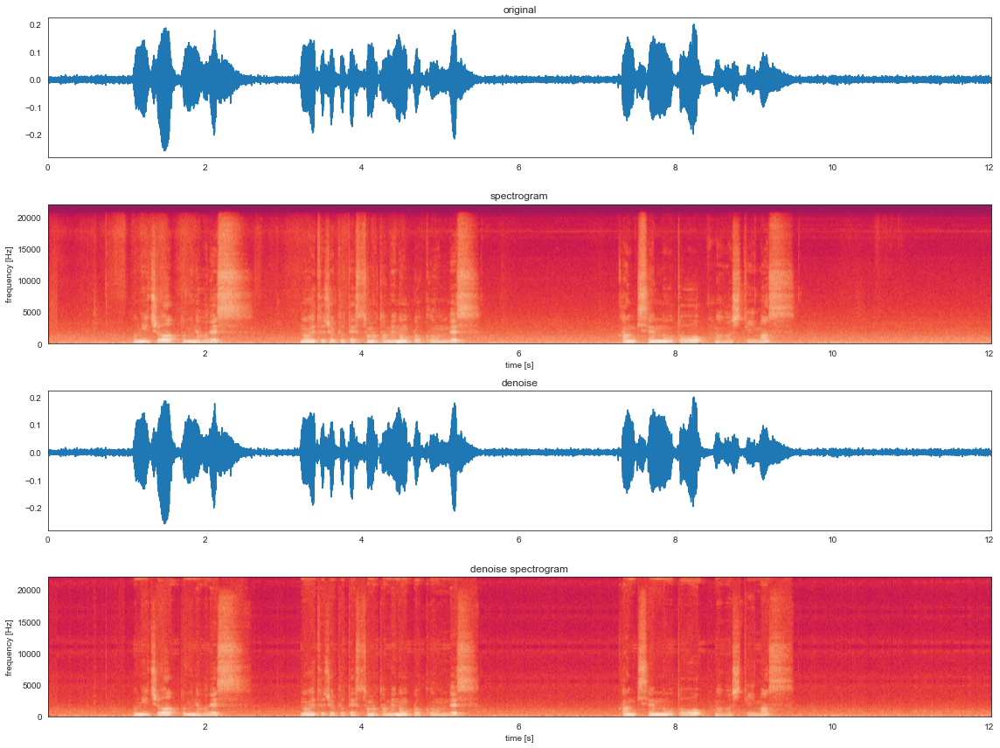

In [124]:
compare_plot(data, denoise_data)

閾値を調整してみる

0.5

0.45

0.4

0.35

0.3

0.25

0.2

0.15

0.1

0.05

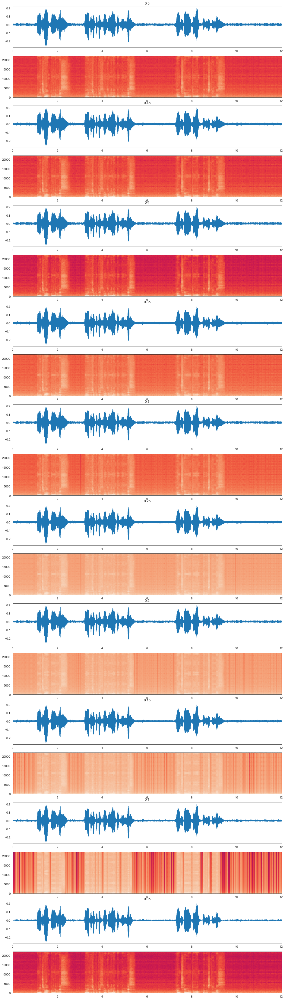

In [125]:
median = np.median(coeff[-1])

start = 0.5
end   = 0.05
step  = 0.05

num = int((start-end)/step)+1
fig, axs = plt.subplots(2*num, 1, figsize=(16, num*6))

for i in range(num):
    alpha = round(start - i*step, 2)
    coeff_ = pywt.wavedec(data, 'db1', mode='per')
    sigma = np.median(abs(coeff_[-1]-median)) / alpha
    threshold = sigma*np.sqrt(2*np.log(len(data)))
    coeff_[1:] = (pywt.threshold(ii, value=threshold, mode='hard') for ii in coeff_[1:])
    denoise_data = pywt.waverec(coeff_, 'db1', mode='per')

    xs = np.arange(0, len(denoise_data)) / sr
    axs[2*i].plot(xs, denoise_data)
    axs[2*i].set_title(alpha)
    axs[2*i].set_xlim(0, len(denoise_data)/sr)
    axs[2*i-1].specgram(denoise_data, Fs=sr)
    axs[2*i-1].set_ylim(0, sr/2)

    ipd.display(alpha)
    ipd.display(ipd.Audio(denoise_data, rate=sr))

---
### 実信号wavelet

音声が含まれない区間(10~12s)の一部をトリミングする

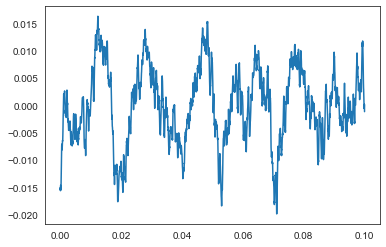

In [126]:
start = int(10.0*sr)
end = int(10.1*sr)
noise = data[start:end]

xs = np.arange(0, len(noise)) / sr
plt.plot(xs, noise)

２周期ぐらいっぽいところでトリミングしてみる

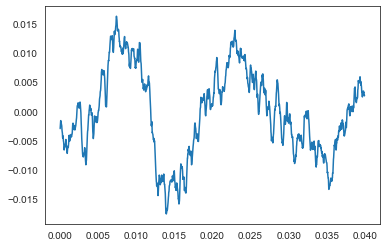

In [127]:
start = int(10.005*sr)
end = int(10.045*sr)

noise = data[start:end]

xs = np.arange(0, len(noise)) / sr
plt.plot(xs, noise)

窓関数→正規化→ヒルベルト変換

In [128]:
han_win = np.hanning(len(noise))
noise_han = noise*han_win
noise_norm = noise_han * (1/np.sqrt(np.sum(noise_han**2)))

fft_noise_norm = np.fft.fft(noise_norm)
N = len(noise_norm)
freq = np.fft.fftfreq(N, d=1/sr)

cond1_i = np.where(freq > 0)
cond2_i = np.where(freq == 0)
cond3_i = np.where(freq < 0)
fft_noise_norm_ = np.zeros(len(fft_noise_norm))
fft_noise_norm_[cond1_i] = 2*fft_noise_norm[cond1_i]
fft_noise_norm_[cond2_i] = fft_noise_norm[cond2_i]
fft_noise_norm_[cond3_i] = 0

crmw = np.fft.ifft(fft_noise_norm_)

wavelet変換

'Before'

'After'

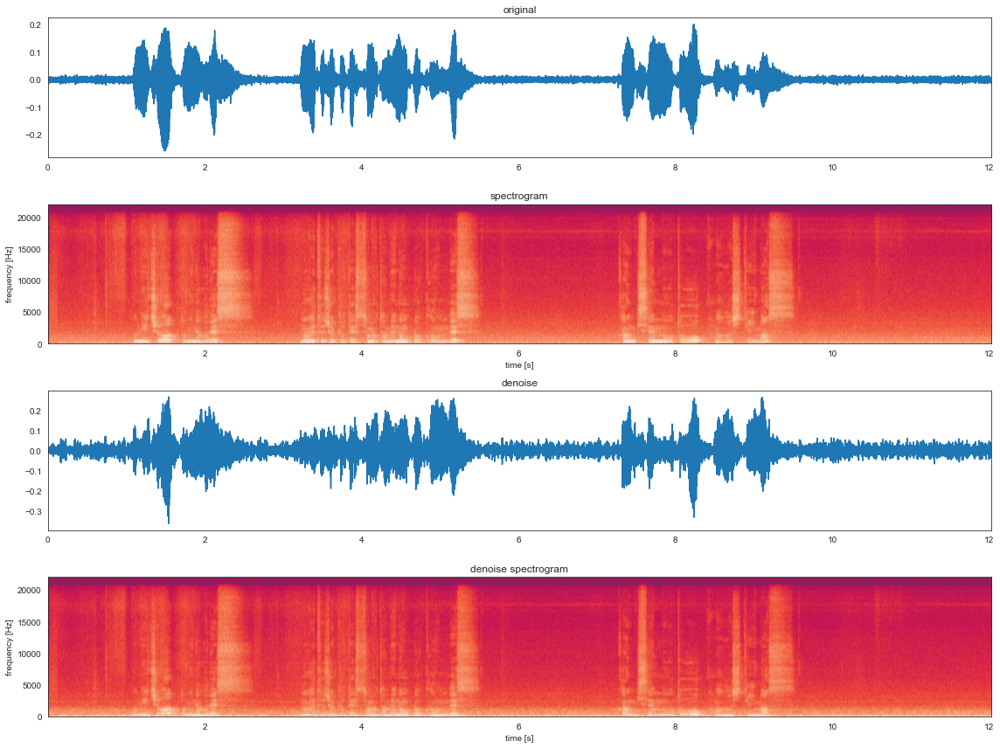

In [129]:
data_crmw = np.convolve(data, crmw, mode='same')
xs = np.arange(0, len(data_crmw)) / sr

denoise_data2 = data - data_crmw

compare_plot(data, denoise_data2)